In [139]:
# Set up libraries and backend
from qiskit.tools.jupyter import * 
from qiskit import IBMQ
from qiskit import assemble
import numpy as np
import matplotlib.pyplot as plt
from qiskit import pulse
from qiskit.pulse import pulse_lib
from qiskit.pulse import Play
from qiskit.pulse.commands import SamplePulse
from qiskit.tools.monitor import job_monitor
from scipy.optimize import curve_fit
import json 

%config InlineBackend.figure_format = 'svg'
IBMQ.load_account()
provider = IBMQ.get_provider(hub='ibm-q', group='open', project='main')
backend = provider.get_backend('ibmq_armonk')
backend_config = backend.configuration()
assert backend_config.open_pulse, "Backend doesn't support OpenPulse"

# Use for conversions later
GHz = 1.0e9
MHz = 1.0e6
kHz = 1.0e3
ms = 1.0e-3
us = 1.0e-6
ns = 1.0e-9
scale_factor = 1e-14

# Initialize qubit to |0> and retrieve backend frequencies
qubit = 0
dt = backend_config.dt
backend_defaults = backend.defaults()
qubit_props_dict = backend.properties().qubit_property(0)
rough_qubit_freq = qubit_props_dict['frequency'][0]
rough_cav_freq = backend_defaults.meas_freq_est[qubit]


# Define and configure measurement map (hardware constraint)
meas_map_idx = None
for i, measure_group in enumerate(backend_config.meas_map):
    if qubit in measure_group:
        meas_map_idx = i
        break
assert meas_map_idx is not None, f"Couldn't find qubit {qubit} in meas_map!"
drive_chan = pulse.DriveChannel(qubit)
meas_chan = pulse.MeasureChannel(qubit)
acq_chan = pulse.AcquireChannel(qubit)
qubit_meas_group = backend_config.meas_map[meas_map_idx]
inst_sched_map = backend_defaults.instruction_schedule_map
measure = inst_sched_map.get('measure', qubits=qubit_meas_group)


# Define for convenience
def get_closest_multiple_of_16(num):
    return int(num + 8) - (int(num + 8) % 16)

# Save and retrieve data from external text files
def save_data(dataset, file):
    filehandler = open(file, 'w')
    json.dump(dataset, filehandler)
    filehandler.close()

def load_data(file):
    filehandler = open(file)
    dataset = json.load(filehandler)
    filehandler.close()
    return dataset

# Get list of data points (complex-valued) from result of job
def get_job_data(job):
    sweep = []
    result = job.result(timeout=120)
    for i in range(len(result.results)):
        res = result.get_memory(i)*scale_factor
        sweep.append(res[qubit])
    return sweep

# Define curve fitting function
def fit_function(x_values, y_values, function, init_params):
    fitparams, conv = curve_fit(function, x_values, y_values, init_params, maxfev=200000)
    y_fit = function(x_values, *fitparams)
    return fitparams, y_fit

ibmqfactory.load_account:WARNING:2020-08-20 15:41:08,943: Credentials are already in use. The existing account in the session will be replaced.


In [71]:
# Design pi pulse
pi_data = load_data('pipulse.txt')
pi_amp = pi_data["pi_amp"] # from calibration experiment
drive_sigma_us = pi_data["drive_sigma_us"] # Width of the gaussian pulse
drive_samps_us = pi_data["drive_samps_us"] # Truncates duration of gaussian to be finite

drive_sigma = get_closest_multiple_of_16(drive_sigma_us * us /dt)       # Puts width in units of dt
drive_samps = get_closest_multiple_of_16(drive_samps_us * us /dt)   # Puts duration in units of dt

mod_pi_pulse = pulse_lib.gaussian(duration=drive_samps, amp=pi_amp, 
                              sigma=drive_sigma, name='pi_pulse') # build pulse based on amp found

In [72]:
# Build freq array
freq_span_Hz = 500 * MHz
num_freqs = 65 # Slightly under max # samples allowed
freq_min_Hz = rough_qubit_freq - freq_span_Hz * (19 / 20) # skewed to accommodate peaks in data efficiently
freq_max_Hz = rough_qubit_freq + freq_span_Hz * (1 / 20)
freq_GHz = np.linspace(freq_min_Hz / GHz, freq_max_Hz / GHz, num_freqs)
freq_Hz = freq_GHz * GHz

# Assign freqs to schedule (for later use)
schedule_freqs = [{drive_chan: freq} for freq in freq_Hz]
print(freq_GHz)

[4.49943815 4.50725065 4.51506315 4.52287565 4.53068815 4.53850065
 4.54631315 4.55412565 4.56193815 4.56975065 4.57756315 4.58537565
 4.59318815 4.60100065 4.60881315 4.61662565 4.62443815 4.63225065
 4.64006315 4.64787565 4.65568815 4.66350065 4.67131315 4.67912565
 4.68693815 4.69475065 4.70256315 4.71037565 4.71818815 4.72600065
 4.73381315 4.74162565 4.74943815 4.75725065 4.76506315 4.77287565
 4.78068815 4.78850065 4.79631315 4.80412565 4.81193815 4.81975065
 4.82756315 4.83537565 4.84318815 4.85100065 4.85881315 4.86662565
 4.87443815 4.88225065 4.89006315 4.89787565 4.90568815 4.91350065
 4.92131315 4.92912565 4.93693815 4.94475065 4.95256315 4.96037565
 4.96818815 4.97600065 4.98381315 4.99162565 4.99943815]


In [73]:
# Acquisition + measurement parameters 
meas_amp = 0.3 # large amplitude
acq_samp_us = 0.05 # on for while to avg out oscillations
meas_sigma_us = 0.01
meas_risefall_us = 0.01

acq_samp = get_closest_multiple_of_16(acq_samp_us * us/dt)
meas_sigma = get_closest_multiple_of_16(meas_sigma_us * us/dt)
meas_risefall = get_closest_multiple_of_16(meas_risefall_us * us/dt)


# Essentially square pulse
meas_pulse = pulse_lib.gaussian_square(duration=acq_samp, amp=meas_amp, sigma=meas_sigma, risefall=meas_risefall)

# Define measurement schedule
meas_schedule = pulse.Schedule(name="Measurement")
meas_schedule += Play(meas_pulse, meas_chan)
meas_schedule += pulse.Acquire(duration=acq_samp, 
                               channel=[pulse.AcquireChannel(i) for i in qubit_meas_group],
                               mem_slot=[pulse.MemorySlot(i) for i in qubit_meas_group])

In [74]:
# Define cavity drive parameters
cav_amp_min = 0.0
cav_amp_max = 1.0
num_amps = 50
cav_amps = np.linspace(cav_amp_min, cav_amp_max, num_amps) # Vary amplitude by which cavity is driven
cavity_dur_us = 6.0 # on for majority of experiment

cavity_dur = get_closest_multiple_of_16(cavity_dur_us * us/dt)

In [75]:
# Construct schedules, one for each cavity power amplitude
schedules = []
dur0 = cavity_dur - drive_samples # parameter to specify where pi pulse is inserted in schedules
for amp in cav_amps:
    master_schedule = pulse.Schedule(name="Master")
    cavity_pulse = pulse_lib.gaussian_square(duration=cavity_dur, amp=amp, sigma=meas_sigma, risefall=meas_risefall)
    master_schedule += Play(cavity_pulse, meas_chan)
    master_schedule += Play(mod_pi_pulse, drive_chan) << dur0
    master_schedule += meas_schedule
    schedules.append(master_schedule)

In [76]:
# Draw sample schedules
schedules[35].draw()

In [77]:
num_shots = 1024
programs = [] # Stores qobj for each amplitude
for sched in schedules: 
    program = assemble(sched, backend=backend, meas_level=1, 
                       meas_return='avg', shots=num_shots, schedule_los=schedule_freqs)
    programs.append(program)

In [78]:
jobs = [] # Stores job info for each amp
jobIDs = [] # Stores corresponding jobIDs
counter = 0 # Counter to keep track of job # in for loop

for program in programs: 
    counter += 1
    job = backend.run(program)
    tag = job.job_id()
    print (f"{tag} is job number {counter}")
    job_monitor(job)
    jobs.append(job)
    jobIDs.append(tag)

5f3c2a14b5e84400131f207d is job number 1
Job Status: job has successfully run
5f3c2acb474efe001553d45c is job number 2
Job Status: job has successfully run
5f3c2f756d358b00135193c2 is job number 3
Job Status: job has successfully run
5f3c34ebc1ef4e001396204e is job number 4
Job Status: job has successfully run
5f3c3b0b959027001275c2e6 is job number 5
Job Status: job has successfully run
5f3c4111ba57970013bbb59d is job number 6
Job Status: job has successfully run
5f3c47b9c9fb290012a591d7 is job number 7
Job Status: job has successfully run
5f3c51c5b5e84400131f2241 is job number 8
Job Status: job has successfully run
5f3c5254289ceb0013d7a87c is job number 9
Job Status: job has successfully run
5f3c52e5959027001275c3f9 is job number 10
Job Status: job has successfully run
5f3c534e289ceb0013d7a886 is job number 11
Job Status: job has successfully run
5f3c53bac9fb290012a59258 is job number 12
Job Status: job has successfully run
5f3c5424c1ef4e00139621a0 is job number 13
Job Status: job has

In [79]:
jobs[0].error_message()

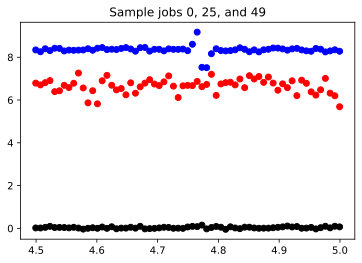

In [80]:
sweeps = [] # Extract results, add data to master array
for job in jobs: 
    sweep = get_job_data(job)
    sweeps.append(sweep)
    
    
# Plot sample datasets to get sense of where peaks appear
plt.scatter(freq_GHz, sweeps[0], color='black')
plt.scatter(freq_GHz, sweeps[25], color='blue')
plt.scatter(freq_GHz, sweeps[49], color='red')
plt.title("Sample jobs 0, 25, and 49")
plt.show()

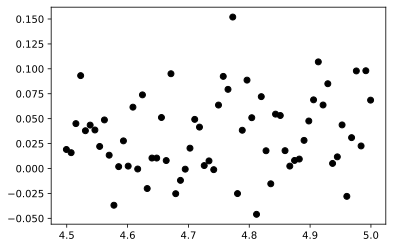

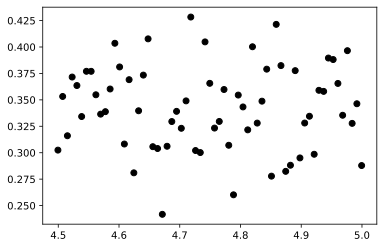

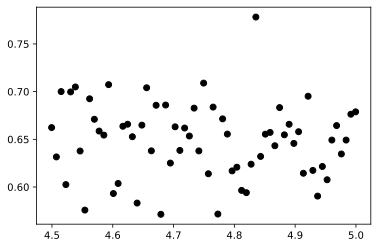

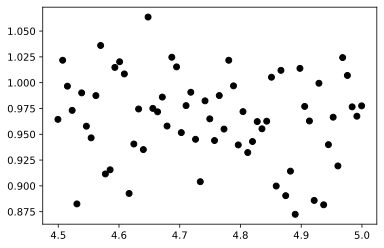

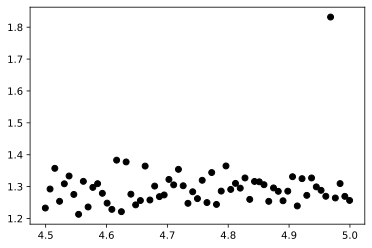

...

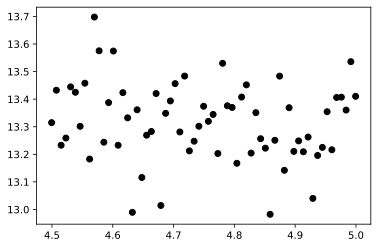

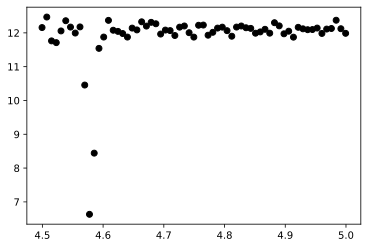

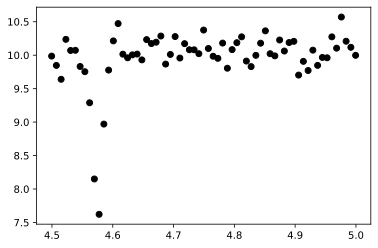

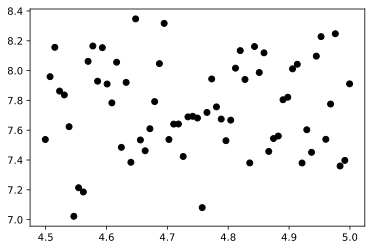

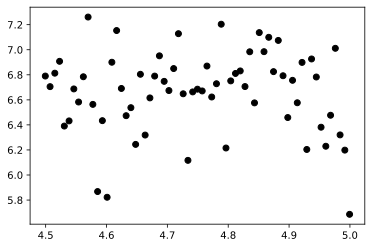

In [81]:
# Plot each individual sweep
for sweep in sweeps:
    plt.scatter(freq_GHz, sweep, color='black')
    plt.show()

In [82]:
# Store relative peaks and orientation (whether maxima or minima)

rough_freqs_GHz = [] # Stores extremum of each sweep, whether min or max
orient = [] # true if extremum = maximum, false if extremum = minimum
for sweep in sweeps: 
    max_sweep = max(sweep)
    min_sweep = min(sweep)
    mean_sweep = np.mean(sweep)
    max_dist = abs(max_sweep - mean_sweep)
    min_dist = abs(min_sweep - mean_sweep)
    if (max_dist > min_dist): # Compares distance of min and max from mean to see which more pronounced
        rough_freqs_GHz.append(freq_GHz[sweep.index(max_sweep)])
        orient.append(True)
    else:
        rough_freqs_GHz.append(freq_GHz[sweep.index(min_sweep)])
        orient.append(False)
        
rough_freqs_Hz = (np.asarray(rough_freqs_GHz) * GHz).tolist()

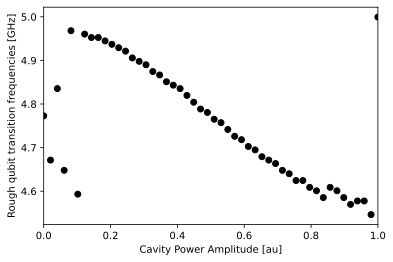

In [83]:
# Observe (hopefully) linear behavior, see how good approximation is

plt.scatter(cav_amps, rough_freqs_GHz, color='black')
plt.xlim([min(cav_amps), max(cav_amps)])
plt.xlabel("Cavity Power Amplitude [au]")
plt.ylabel("Rough qubit transition frequencies [GHz]")
plt.show()

In [84]:
# Function for removing outliers from line, in order for fit to have more faithful parameters
def remove_lin_outliers(x_data, y_data, slope_guess, y_int_guess, thresh):
    # First fit 'sloppy' line to get approx slope
    fit_params, fit = fit_function(x_data, y_data,
                                    lambda x, A, B: A*x + B,
                                    [slope_guess, y_int_guess])
    this_slope, this_y_int = fit_params
    new_x_data = []
    new_y_data = []
    for i in range(len(x_data)):
        y_obs = y_data[i]
        y_exp = fit[i]
        if (abs(y_obs - y_exp) < thresh):  
            new_x_data.append(x_data[i])
            new_y_data.append(y_obs)
    return np.asarray(new_x_data), new_y_data

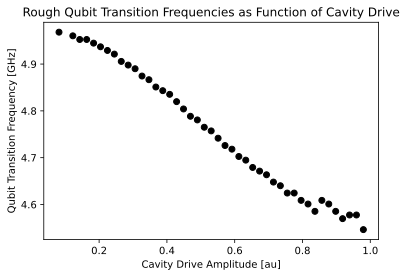

In [124]:
rough_cav_amps, rough_qubit_freqs = remove_lin_outliers(cav_amps, rough_freqs_GHz, -0.3, 5, 0.1)
rough_cav_amps, rough_qubit_freqs = remove_lin_outliers(rough_cav_amps, rough_qubit_freqs, -0.3, 5, 0.1)
rough_qubit_freqs_Hz = (np.asarray(rough_qubit_freqs) * GHz).tolist()

# Plot data with outliers removed
plt.scatter(rough_cav_amps, rough_qubit_freqs, color='black')
plt.title("Rough Qubit Transition Frequencies as Function of Cavity Drive")
plt.xlabel("Cavity Drive Amplitude [au]")
plt.ylabel("Qubit Transition Frequency [GHz]")
plt.show()

In [125]:
# create amplitude-specific frequency sweep arrays to allow for better curve fitting --> better freq estimates
mod_freqs_GHz = [] # list of freq sweep arrays
mod_freqs_Hz = []
for freq in rough_qubit_freqs_Hz: # center each sweep on approximate guess
    mod_freq_span = 60 * MHz
    mod_freq_min = freq - mod_freq_span / 2
    mod_freq_max = freq + mod_freq_span / 2
    mod_freq_GHz = np.linspace(mod_freq_min / GHz, mod_freq_max / GHz, num_freqs)
    mod_freq_Hz = mod_freq_GHz * GHz
    mod_freqs_GHz.append(mod_freq_GHz)
    mod_freqs_Hz.append(mod_freq_Hz)

In [126]:
# Assemble modified schedule freqs
mod_schedule_freqs = []
for freq_array in mod_freqs_Hz: 
    mod_schedule_freq = [{drive_chan: freq} for freq in freq_array]
    mod_schedule_freqs.append(mod_schedule_freq)
    
mod_schedules = []
for amp in rough_cav_amps: # use only amps that didn't correspond to outlying data pts (those sweeps won't help)
    master_schedule = pulse.Schedule(name="Master")
    cavity_pulse = pulse_lib.gaussian_square(duration=cavity_dur, amp=amp, sigma=meas_sigma, risefall=meas_risefall)
    master_schedule += Play(cavity_pulse, meas_chan)
    master_schedule += Play(mod_pi_pulse, drive_chan) << dur0
    master_schedule += meas_schedule
    mod_schedules.append(master_schedule)

In [127]:
# Modified programs
mod_programs = []
for i in range (len(mod_schedules)):
    mod_program = assemble(mod_schedules[i], backend=backend, meas_level=1, 
                       meas_return='avg', shots=num_shots, schedule_los=mod_schedule_freqs[i])
    mod_programs.append(mod_program)

In [128]:
# Run and store modified jobs
mod_jobs = []
mod_job_IDs = []
j = 0
for mod_program in mod_programs: 
    j += 1
    mod_job = backend.run(mod_program)
    mod_tag = mod_job.job_id()
    print(f"Job {mod_tag} is job number {j}.")
    job_monitor(mod_job)
    mod_jobs.append(mod_job)
    mod_job_IDs.append(mod_tag)

Job 5f3d67794727e500140eac6d is job number 1.
Job Status: job has successfully run
Job 5f3d6a11ef910e0012bcaa25 is job number 2.
Job Status: job has successfully run
Job 5f3d6c24289ceb0013d7b63b is job number 3.
Job Status: job has successfully run
Job 5f3d6e4def910e0012bcaa52 is job number 4.
Job Status: job has successfully run
Job 5f3d708f05d17a0014edb2f7 is job number 5.
Job Status: job has successfully run
Job 5f3d730d05d17a0014edb31d is job number 6.
Job Status: job has successfully run
Job 5f3d7587959027001275d205 is job number 7.
Job Status: job has successfully run
Job 5f3d7833f668140012eeda15 is job number 8.
Job Status: job has successfully run
Job 5f3d7add289ceb0013d7b6d2 is job number 9.
Job Status: job has successfully run
Job 5f3d7e01474efe001553e4da is job number 10.
Job Status: job has successfully run
Job 5f3d811405d17a0014edb397 is job number 11.
Job Status: job has successfully run
Job 5f3d843a804d6b0012eeef1f is job number 12.
Job Status: job has successfully run
J

In [129]:
# Extract modified sweeps
mod_sweeps = []
for mod_job in mod_jobs: 
    mod_sweep = get_job_data(mod_job)
    mod_sweeps.append(mod_sweep)

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


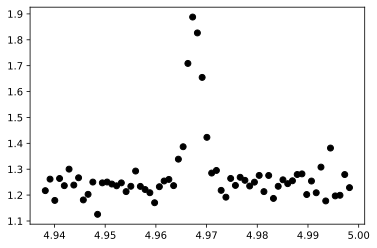

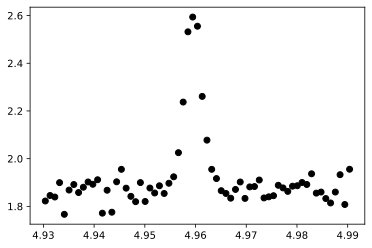

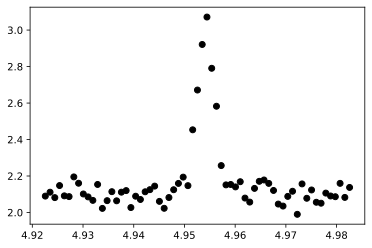

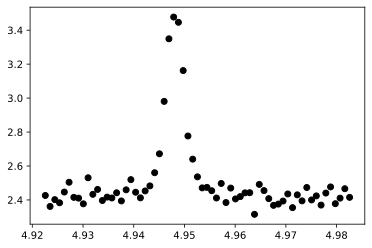

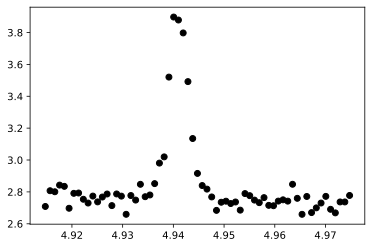

...

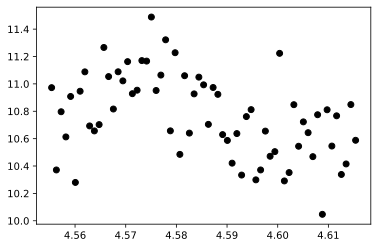

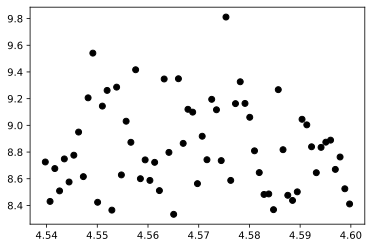

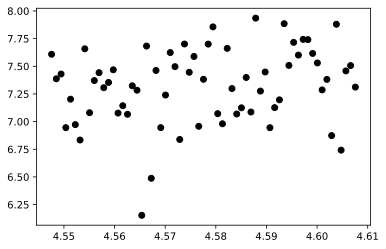

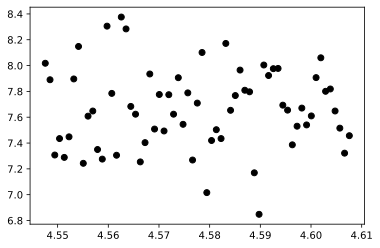

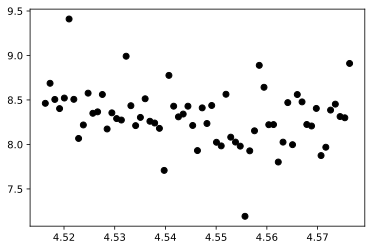

In [141]:
mod_orients = []

for i in range(len(mod_sweeps)):
    plt.scatter(mod_freqs_GHz[i], mod_sweeps[i], color='black') # Plot mod sweeps
    plt.show()
    
    max_sweep = max(mod_sweeps[i])
    min_sweep = min(mod_sweeps[i])
    mean = np.mean(mod_sweeps[i])
    max_dist = abs(max_sweep - mean)
    min_dist = abs(min_sweep - mean)
    
    if (max_dist > min_dist):
        mod_orients.append(True)
    else:
        mod_orients.append(False)

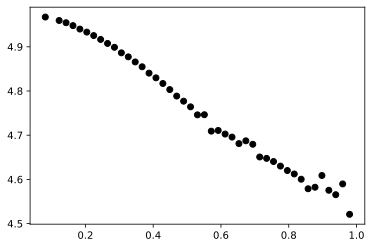

In [143]:
peak_guesses = [] # Store extrema of modified sweeps 
for i in range (len(mod_sweeps)):
    if (mod_orients[i]):
        peak_guess = mod_freqs_GHz[i][mod_sweeps[i].index(max(mod_sweeps[i]))]
    else: 
        peak_guess = mod_freqs_GHz[i][mod_sweeps[i].index(min(mod_sweeps[i]))]
    peak_guesses.append(peak_guess)
    
plt.scatter(rough_cav_amps, peak_guesses, color='black') # Plot to confirm lack of outliers
plt.show()

count = 1


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


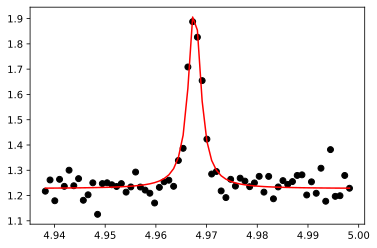

count = 2


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


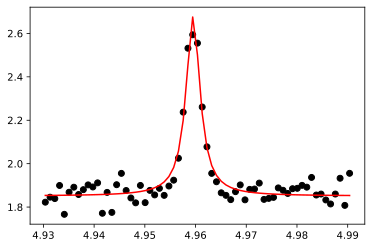

count = 3


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


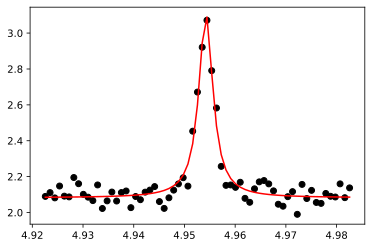

count = 4


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


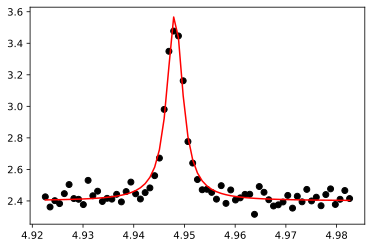

count = 5


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


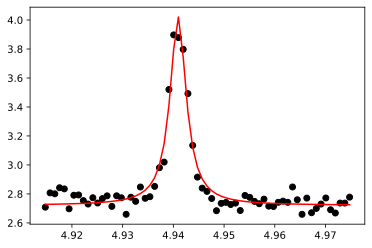

count = 6


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


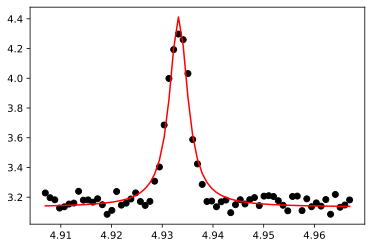

count = 7


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


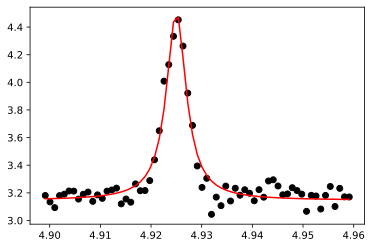

count = 8


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


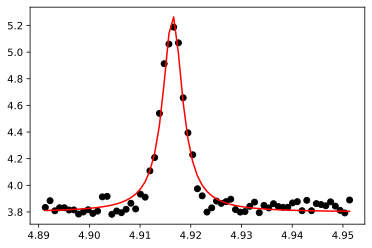

count = 9


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


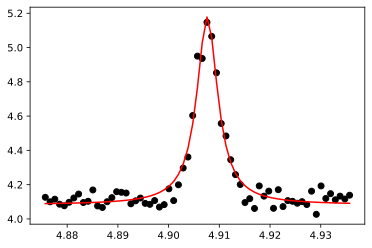

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


count = 10


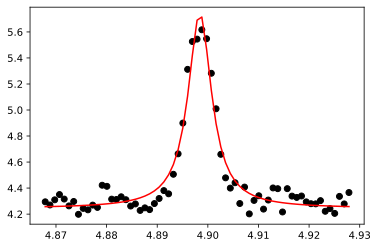

count = 11


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


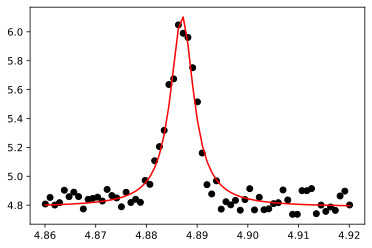

count = 12


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


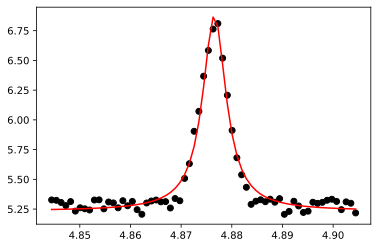

count = 13


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


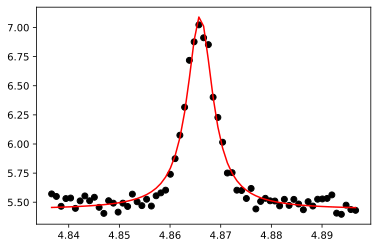

count = 14


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


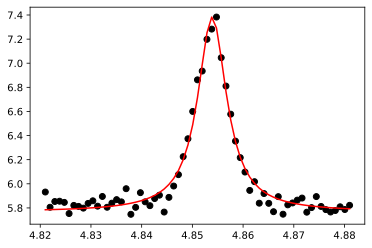

count = 15


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


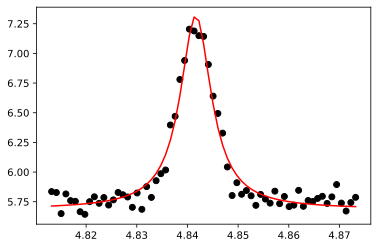

count = 16


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


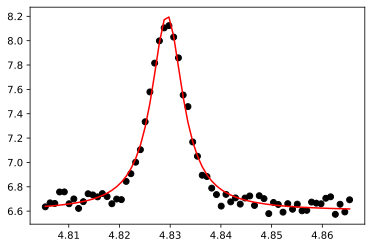

count = 17


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


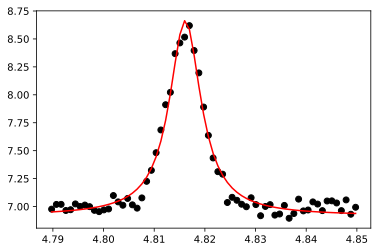

count = 18


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


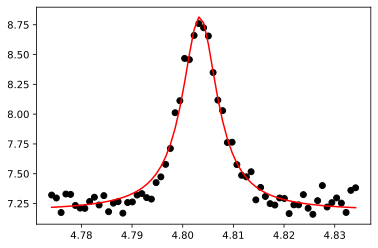

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


count = 19


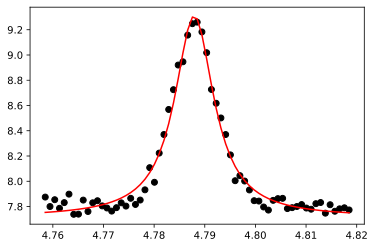

count = 20


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


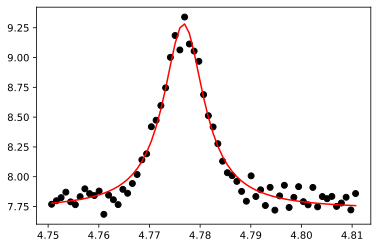

count = 21


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


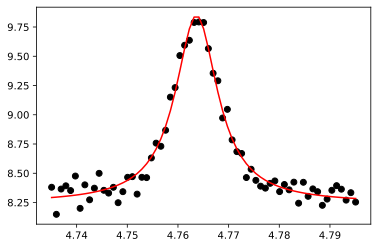

count = 22


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


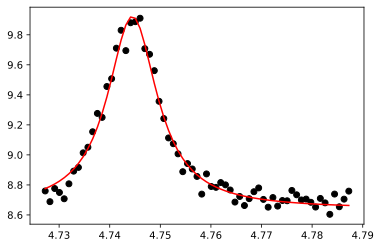

count = 23


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


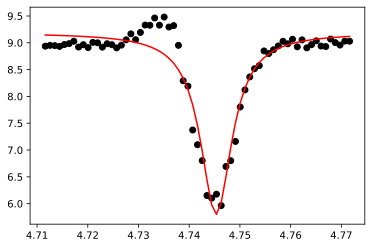

count = 24


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


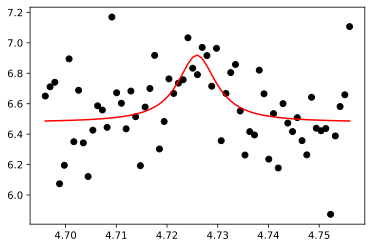

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


count = 25


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


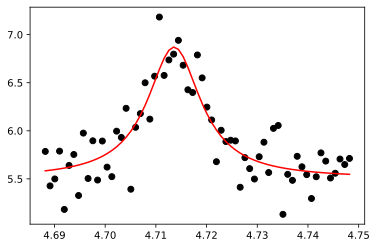

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


count = 26


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


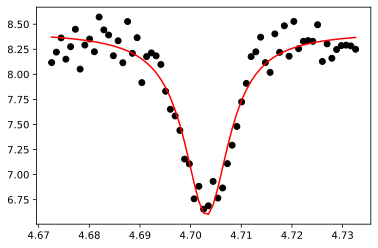

count = 27


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


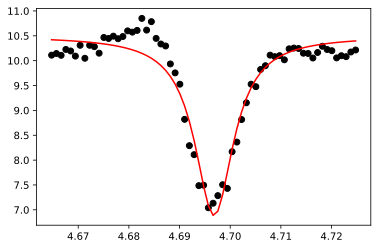

count = 28


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


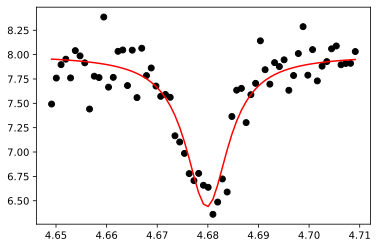

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


count = 29


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


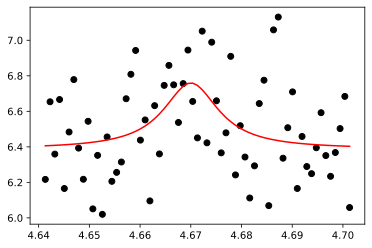

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


count = 30


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


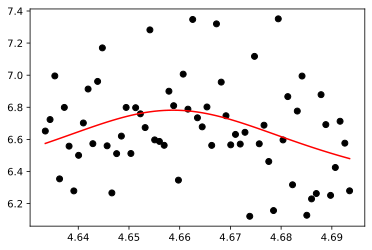

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


count = 31


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


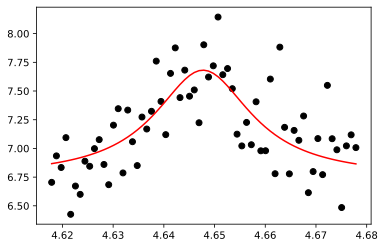

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


count = 32


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


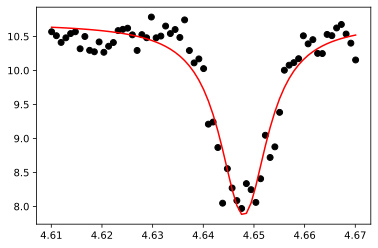

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


count = 33


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


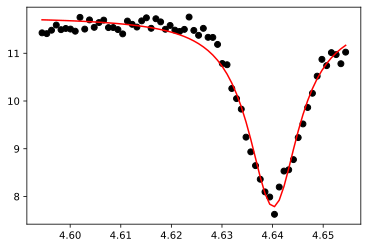

count = 34


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


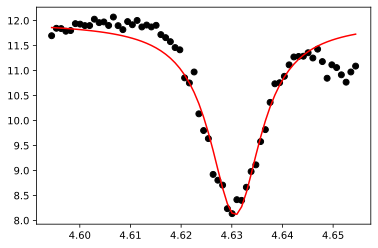

count = 35


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


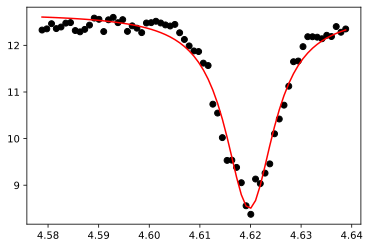

count = 36


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


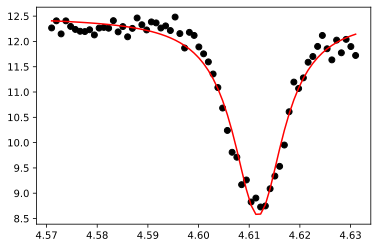

count = 37


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


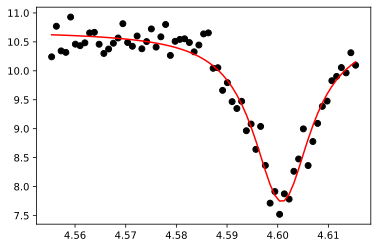

count = 38


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


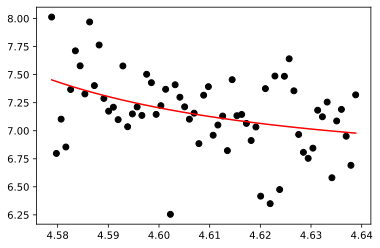

count = 39


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


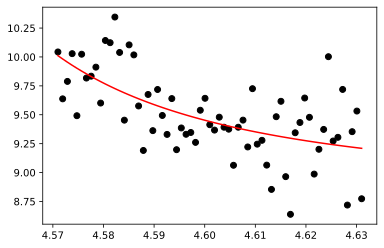

count = 40


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


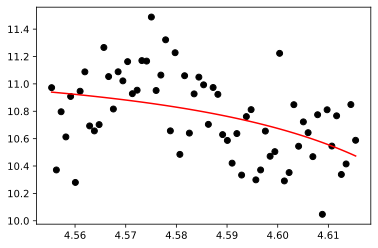

count = 41


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


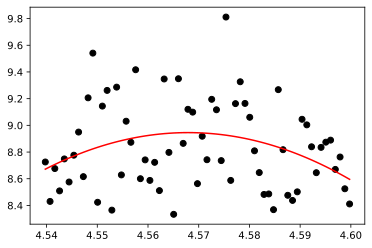

/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


count = 42


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


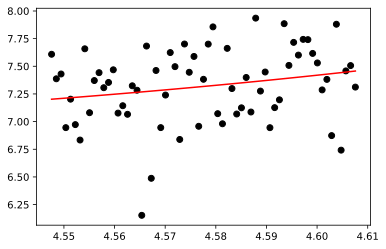

count = 43


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


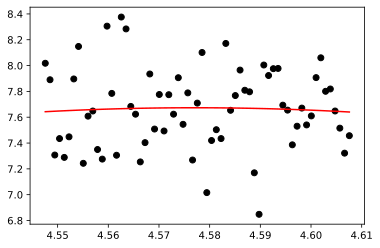

count = 44


/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/envs/newerQiskit/lib/python3.7/site-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


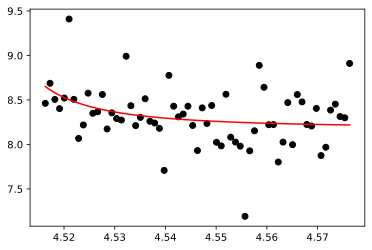

In [144]:
# Fit all sets of sweeps, extract peak frequency values for each, store these as amp-specific qubit transition freqs
mod_qubit_freqs = []
mod_freq_fits = []
levels = []
count = 0

for i in range(len(mod_sweeps)):
    count += 1 # Keeps track of plots
    print(f"count = {count}")
    if (mod_orients[i]):
        # fits to pos-valued amplitude (100) for sweeps with largest extremum as max
        mod_freq_params, mod_freq_fit = fit_function(mod_freqs_GHz[i], mod_sweeps[i], 
             lambda x, A, mod_qubit_freq, B, C: (A / np.pi) * (B / ((x - mod_qubit_freq)**2 + B**2)) + C,
            [100, peak_guess, 1, -2]) 
        
    else: 
        # fits to neg-valued amplitude (-100) for sweeps with largest extremum as min
        mod_freq_params, mod_freq_fit = fit_function(mod_freqs_GHz[i], mod_sweeps[i], 
             lambda x, A, mod_qubit_freq, B, C: (A / np.pi) * (B / ((x - mod_qubit_freq)**2 + B**2)) + C,
            [-100, peak_guess, 1, -2]) 
        
    _, mod_qubit_freq, _, _ = mod_freq_params # stores qubit freq based on fit
    mod_qubit_freqs.append(mod_qubit_freq)
    mod_freq_fits.append(mod_freq_fit)
    
    # Make sure fit is faithful (otherwise recalibrate fit_function parameters so that accurate freqs are stored)
    plt.scatter(mod_freqs_GHz[i], mod_sweeps[i], color='black')
    plt.plot(mod_freqs_GHz[i], mod_freq_fit, color='red')
    plt.show()

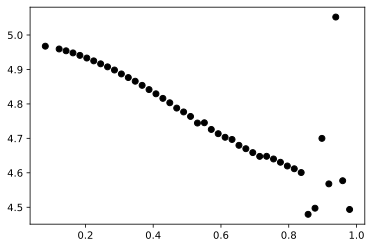

In [145]:
# Plot freqs vs drive to check for outliers
plt.scatter(rough_cav_amps, mod_qubit_freqs, color='black')
plt.show()

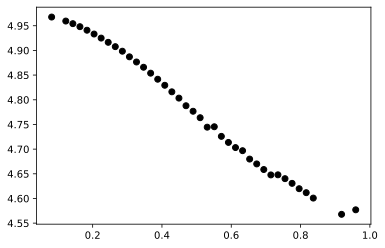

In [151]:
# Remove outliers again
resized_mod_cav_amps, resized_mod_qubit_freqs = remove_lin_outliers(rough_cav_amps, mod_qubit_freqs, -0.5, 5, 0.05)

# Plot to confirm lack of outliers
plt.scatter(resized_mod_cav_amps, resized_mod_qubit_freqs, color='black')
plt.show()

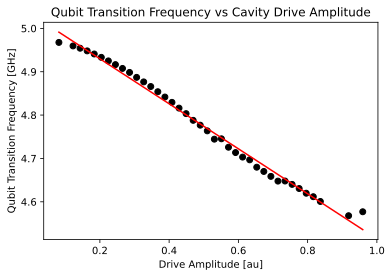

In [152]:
# Fit for final parameters 
final_params, final_y_fit = fit_function(resized_mod_cav_amps, resized_mod_qubit_freqs,
                                        lambda x, A, B: A*x + B, [-0.5, 5])
final_slope, final_y_int = final_params
plt.scatter(resized_mod_cav_amps, resized_mod_qubit_freqs, color='black')
plt.plot(resized_mod_cav_amps, final_y_fit, color='red')
plt.title("Qubit Transition Frequency vs Cavity Drive Amplitude")
plt.xlabel("Drive Amplitude [au]")
plt.ylabel("Qubit Transition Frequency [GHz]")
plt.show()

In [155]:
# Store data externally

this_data = {'meas_amp': meas_amp, 'acq_dur_us': acq_samp_us, 'cav_amps': cav_amps.tolist(), 'num_freqs': num_freqs,
             'generic_freqs': freq_GHz.tolist(), 'rough_extrema': rough_freqs_GHz, 
             'rough_cav_amps': rough_cav_amps.tolist(),'rough_qubit_freqs': rough_qubit_freqs, 
             'mod_freq_span': mod_freq_span, 'mod_orients': mod_orients, 'peak_guesses': peak_guesses, 
             'mod_qubit_freqs' : mod_qubit_freqs,'final_cav_amps': resized_mod_cav_amps.tolist(), 
             'final_qubit_freqs': resized_mod_qubit_freqs,'final_slope': final_slope, 'final_y_int': final_y_int,
             'job_IDs': jobIDs, 'mod_job_IDs': mod_job_IDs, 'chi_amp_ratio_GHz_au': abs(final_slope)}

save_data(this_data, 'QubitFrequencyVsPulseAmplitudeMore.txt')
save_data(this_data, 'QubitFrequencyVsPulseAmplitudeMore_1.txt')